# Estimate the energy density in the eps cone for DBSCAN tuning

In [6]:
import sys
sys.path.insert(0, '..')
import ROOT
import root_numpy as rnp
import l1THistos as histos
import math
import uuid

ROOT.enableJSVis()

from drawingTools import *


In [7]:
def extractIntegral(histo, debug=False):
    growingInteg = 0
    integ = histo.Integral(1, histo.GetNbinsX()+1)
    ret = list()
    for bin in range(0, histo.GetNbinsX()+1):
        binContent = histo.GetBinContent(bin)
        growingInteg+=binContent
        binl = histo.GetBinLowEdge(bin)
        bw = histo.GetBinWidth(bin)
        dens = binl+bw
        frac = growingInteg*100/integ
        if debug:
            print 'bin: {}, density: {}, fraction: {}'.format(bin, dens, frac)
        if frac == 100:
            break
        ret.append((dens, frac))
    return ret

def getWorkingPoint(densfrac):
    wp = 0.5
    for point_id in range(0, len(densfrac)):
        point = densfrac[point_id]
        if point[1] > wp:
            return densfrac[point_id-1][0]
        
def getWPscan(histos):
    ret = list()
    for hist_idx in range(0, len(histos)):
        densfrac = extractIntegral(histos[hist_idx])
        wp = getWorkingPoint(densfrac)
        ret.append(wp)
    return ret

In [8]:
version = 'v7'

sampleEle25_PU0 = Sample('EleE25', 'PU0', version)
sampleEle50_PU0 = Sample('EleE50', 'PU0', version)

eleSamples_PU0 = [sampleEle25_PU0, sampleEle50_PU0]
elePu_labels = [sample.pu_tag for sample in eleSamples_PU0]

sampleNuGun_PU200 = Sample('NuGun', 'PU200', version)


gammaPt35_PU0 = Sample('photonPt35', 'PU0', 'v10d')
gammaPt50_PU0 = Sample('photonPt50', 'PU0', 'v10d')

gammaSamples_PU0 = [gammaPt35_PU0, gammaPt50_PU0]



In [9]:
hDensity_3p6 = [histos.DensityHistos('h_dens3p6', sample.histo_file) for sample in eleSamples_PU0]
hDensity_2p5 = [histos.DensityHistos('h_dens2p5', sample.histo_file) for sample in eleSamples_PU0]

hDensityNuGun_2p5 = histos.DensityHistos('h_densClus2p5', sampleNuGun_PU200.histo_file)
hDensityNuGun_3p6 = histos.DensityHistos('h_densClus3p6', sampleNuGun_PU200.histo_file)

hDensity_Photon_2p5 = [histos.DensityHistos('h_dens2p5', sample.histo_file) for sample in gammaSamples_PU0]
hDensity_Photon_3p6 = [histos.DensityHistos('h_dens3p6', sample.histo_file) for sample in gammaSamples_PU0]

v7 hack
[]
v7 hack
[]
v7 hack
[]
v7 hack
[]
['h_densClus2p5_eDensityVlayer', 'h_densClus2p5_nTCDensityVlayer']
['h_densClus3p6_eDensityVlayer', 'h_densClus3p6_nTCDensityVlayer']
['h_dens2p5_eDensityVlayer', 'h_dens2p5_nTCDensityVlayer']
['h_dens2p5_eDensityVlayer', 'h_dens2p5_nTCDensityVlayer']
['h_dens3p6_eDensityVlayer', 'h_dens3p6_nTCDensityVlayer']
['h_dens3p6_eDensityVlayer', 'h_dens3p6_nTCDensityVlayer']


## NuGun PU200

In [ ]:
drawAndProfileX(hDensityNuGun_2p5.h_eDensityVlayer, options='COLZ',maxy=30)
drawAndProfileX(hDensityNuGun_3p6.h_eDensityVlayer, options='COLZ',maxy=30)

In [ ]:
hDensityNuGun_layer_3p6 = [hDensityNuGun_3p6.h_eDensityVlayer.ProjectionY(uuid.uuid4().hex[:6], layer, layer) for layer in range(2, 30)]

for idx in range(0,len(hDensityNuGun_layer_3p6)):
    hDensityNuGun_layer_3p6[idx].SetTitle('Layer {}'.format(idx+1))


In [ ]:
for hlayer in hDensityNuGun_layer_3p6:
    draw(hlayer)

In [ ]:
hDensityNuGun_layer_2p5 = [hDensityNuGun_2p5.h_eDensityVlayer.ProjectionY(uuid.uuid4().hex[:6], layer, layer) for layer in range(2, 30)]

for idx in range(0,len(hDensityNuGun_layer_2p5)):
    hDensityNuGun_layer_2p5[idx].SetTitle('Layer {}'.format(idx+1))


In [ ]:
for hlayer in hDensityNuGun_layer_2p5:
    draw(hlayer)

In [ ]:
for id in range(0,28):
    drawSame([hDensityNuGun_layer_2p5[id], hDensityNuGun_layer_3p6[id]], ['eps=2.5', 'eps=3.6'],options='hist')

## Ele 25GeV PU0

The canvas contains an object of a type jsROOT cannot currently handle (TProfile). Falling back to a static png.


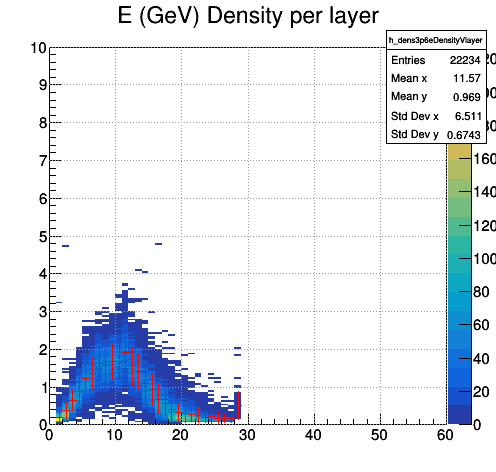

The canvas contains an object of a type jsROOT cannot currently handle (TProfile). Falling back to a static png.


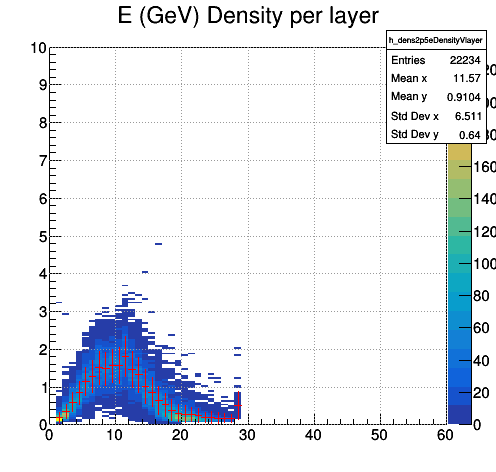

In [10]:

drawAndProfileX(hDensity_3p6[0].h_eDensityVlayer, options='COLZ',maxy=30)
drawAndProfileX(hDensity_2p5[0].h_eDensityVlayer, options='COLZ',maxy=30)



In [11]:
hDensity_layer_3p6 = [hDensity_3p6[0].h_eDensityVlayer.ProjectionY(uuid.uuid4().hex[:6], layer, layer) for layer in range(2, 30)]

for idx in range(0,len(hDensity_layer_3p6)):
    hDensity_layer_3p6[idx].SetTitle('Layer {}'.format(idx+1))


In [12]:
hDensity_layer_2p5 = [hDensity_2p5[0].h_eDensityVlayer.ProjectionY(uuid.uuid4().hex[:6], layer, layer) for layer in range(2, 30)]

for idx in range(0,len(hDensity_layer_2p5)):
    hDensity_layer_2p5[idx].SetTitle('Layer {}'.format(idx+1))


In [13]:
for hlayer in hDensity_layer_3p6:
    draw(hlayer)

In [14]:
for hlayer in hDensity_layer_2p5:
    draw(hlayer)

In [15]:
wplist = getWPscan(hDensity_layer_2p5)
len(wplist)
print wplist

[0.05, 0.05, 0.1, 0.25, 0.3, 0.3, 0.5, 0.45, 0.4, 0.35000000000000003, 0.4, 0.25, 0.25, 0.15000000000000002, 0.1, 0.1, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.15000000000000002]


## Ele 50GeV PU0

The canvas contains an object of a type jsROOT cannot currently handle (TProfile). Falling back to a static png.


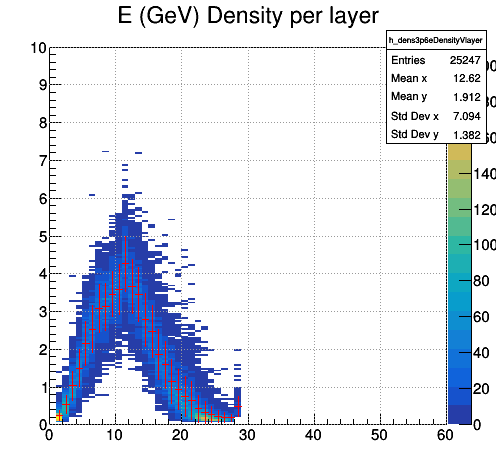

The canvas contains an object of a type jsROOT cannot currently handle (TProfile). Falling back to a static png.


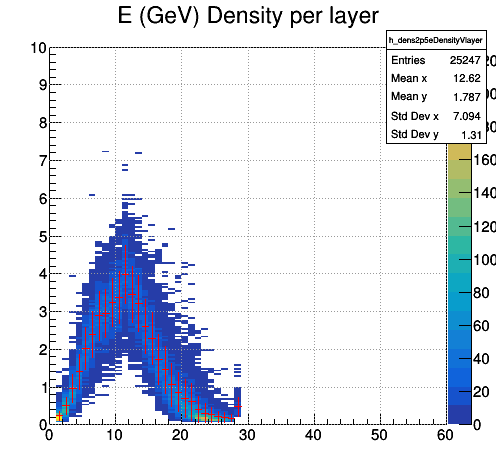

In [25]:
drawAndProfileX(hDensity_3p6[1].h_eDensityVlayer, options='COLZ',maxy=30)
drawAndProfileX(hDensity_2p5[1].h_eDensityVlayer, options='COLZ',maxy=30)


In [26]:
hDensity_layer_3p6 = [hDensity_3p6[1].h_eDensityVlayer.ProjectionY(uuid.uuid4().hex[:6], layer, layer) for layer in range(2, 30)]

for idx in range(0,len(hDensity_layer_3p6)):
    hDensity_layer_3p6[idx].SetTitle('Layer {}'.format(idx+1))


In [27]:
hDensity_layer_2p5 = [hDensity_2p5[1].h_eDensityVlayer.ProjectionY(uuid.uuid4().hex[:6], layer, layer) for layer in range(2, 30)]

for idx in range(0,len(hDensity_layer_2p5)):
    hDensity_layer_2p5[idx].SetTitle('Layer {}'.format(idx+1))


In [28]:
for hlayer in hDensity_layer_3p6:
    draw(hlayer)

In [29]:
for hlayer in hDensity_layer_2p5:
    draw(hlayer)

In [ ]:
for id in range(0,28):
    drawSame([hDensity_layer_2p5[id], hDensity_layer_3p6[id]], ['eps=2.5', 'eps=3.6'],options='hist')

## Photon Pt 35GeV PU0

The canvas contains an object of a type jsROOT cannot currently handle (TProfile). Falling back to a static png.


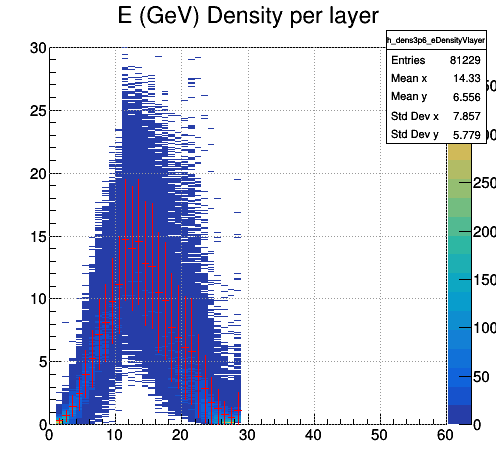

The canvas contains an object of a type jsROOT cannot currently handle (TProfile). Falling back to a static png.


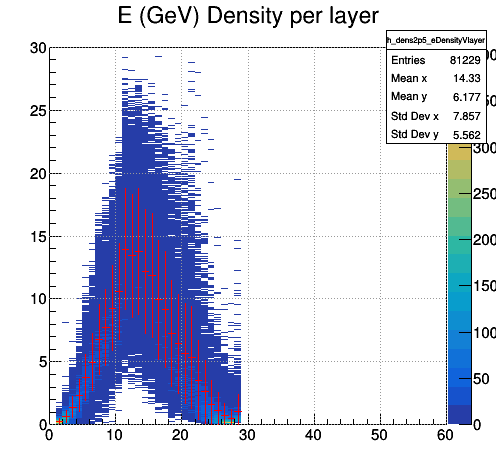

In [67]:
drawAndProfileX(hDensity_Photon_3p6[0].h_eDensityVlayer, options='COLZ',maxy=60)
drawAndProfileX(hDensity_Photon_2p5[0].h_eDensityVlayer, options='COLZ',maxy=60)


In [68]:
hDensity_Photon_layer_3p6 = [hDensity_Photon_3p6[0].h_eDensityVlayer.ProjectionY(uuid.uuid4().hex[:6], layer, layer) for layer in range(2, 30)]

for idx in range(0,len(hDensity_layer_3p6)):
    hDensity_Photon_layer_3p6[idx].SetTitle('Layer {}'.format(idx+1))


In [69]:
hDensity_Photon_layer_2p5 = [hDensity_Photon_2p5[0].h_eDensityVlayer.ProjectionY(uuid.uuid4().hex[:6], layer, layer) for layer in range(2, 30)]

for idx in range(0,len(hDensity_layer_2p5)):
    hDensity_Photon_layer_2p5[idx].SetTitle('Layer {}'.format(idx+1))


In [70]:
for hlayer in hDensity_Photon_layer_3p6:
    draw(hlayer)

In [71]:
for hlayer in hDensity_Photon_layer_2p5:
    draw(hlayer)

In [72]:
densfrac = extractIntegral(hDensity_Photon_layer_2p5[5], True)


bin: 0, density: 0.0, fraction: 0.0
bin: 1, density: 0.05, fraction: 0.0
bin: 2, density: 0.1, fraction: 0.0333778371162
bin: 3, density: 0.15, fraction: 0.100133511348
bin: 4, density: 0.2, fraction: 0.133511348465
bin: 5, density: 0.25, fraction: 0.166889185581
bin: 6, density: 0.3, fraction: 0.267022696929
bin: 7, density: 0.35, fraction: 0.267022696929
bin: 8, density: 0.4, fraction: 0.367156208278
bin: 9, density: 0.45, fraction: 0.43391188251
bin: 10, density: 0.5, fraction: 0.500667556742
bin: 11, density: 0.55, fraction: 0.634178905207
bin: 12, density: 0.6, fraction: 0.700934579439
bin: 13, density: 0.65, fraction: 0.767690253672
bin: 14, density: 0.7, fraction: 0.86782376502
bin: 15, density: 0.75, fraction: 1.00133511348
bin: 16, density: 0.8, fraction: 1.06809078772
bin: 17, density: 0.85, fraction: 1.16822429907
bin: 18, density: 0.9, fraction: 1.26835781041
bin: 19, density: 0.95, fraction: 1.33511348465
bin: 20, density: 1.0, fraction: 1.56875834446
bin: 21, density: 1.0

In [73]:
getWorkingPoint(densfrac)

0.45

In [74]:
wplist = getWPscan(hDensity_Photon_layer_2p5)
len(wplist)
print wplist

[0.05, 0.05, 0.05, 0.1, 0.25, 0.45, 1.1, 1.6, 2.5, 3.55, 4.8500000000000005, 4.6, 4.35, 3.55, 3.15, 2.25, 1.8, 1.05, 1.0, 0.6500000000000001, 0.5, 0.2, 0.1, 0.05, 0.05, 0.05, 0.05, 0.2]


In [63]:
len(wplist)



28